In [81]:
import networkx as nx
import matplotlib.pyplot as plt
import ast

In [183]:
import csv

G = nx.Graph()

with open('../exports/adjacency_2024-03-15.csv', 'r') as csvfile:
    csvreader = csv.reader(csvfile)
    for row in csvreader:
        node = row[0]
        connected_nodes = ast.literal_eval(row[1])
        
        for connected_node in connected_nodes:
            G.add_edge(node, connected_node)

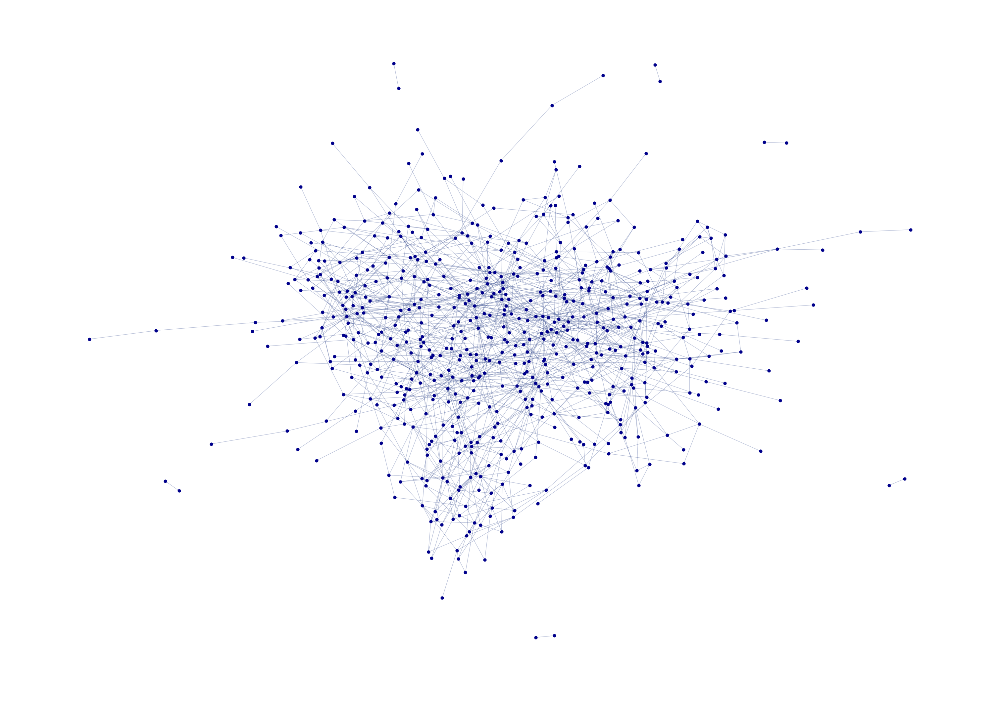

In [182]:
plt.figure(figsize=(30, 21)) 
nx.draw(G, 
        pos = nx.spring_layout(G, k= 0.1, weight='7.0'),
        with_labels = False, 
        font_size = 16, 
        node_size = 40, 
        node_color = 'darkblue', 
        edge_color = (0.1, 0.2, 0.5, 0.3)
       )
plt.show()

In [74]:
# first visualization that I think is somewhat telling
# 1) the graph is very dense
# 2) there are some outliers, disconnected from the main clustered topics

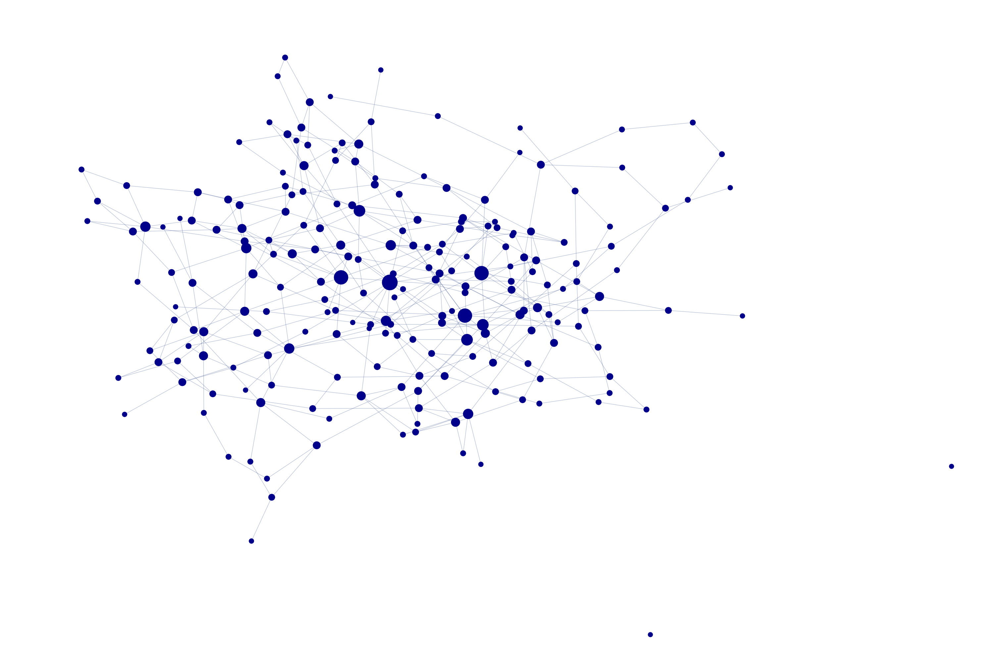

In [164]:
# trying to make it less dense by showing the cluster center
threshold = 4 
main_nodes = [node for node, degree in G.degree() if degree > threshold]

# subgraph for only the nodes that have > 4 edges
H = G.subgraph(main_nodes)


plt.figure(figsize=(30, 20)) 
nx.draw(H, 
        pos = nx.spring_layout(H, k=0.1),
        with_labels = False, 
        node_size = [10 * H.degree(node) ** 2 + 100 for node in H.nodes()], # more edges == bigger node
        node_color = 'darkblue', 
        edge_color = (0.1, 0.2, 0.5, 0.3)
       )
plt.show()

In [91]:
# A subgraph where all nodes with degree < 4 have been removed
# Showing only the most recurrent/similar articles

# what are the two outliers?
# means they're sort of separate from the main topics on HN, but still pop up often 

In [147]:
# adding labels to the most connected nodes + the outliers
# hypothesis being I can derive most trending topic clusters from this
threshold = 6
important_nodes = [node for node, degree in dict(H.degree()).items() if degree > threshold] 
important_nodes += [node for node, degree in dict(H.degree()).items() if degree == 0] 

In [148]:
# get data on the nodes

def get_labels(nodes):
    labels = {id: None for id in nodes}
    import csv
    with open('../exports/export_2024-03-16.csv', 'r') as csvfile:
        csv = csv.reader(csvfile)
        for row in csv:
            id, title, keywords = row
            if id in labels:
                labels[id] = keywords
    return labels

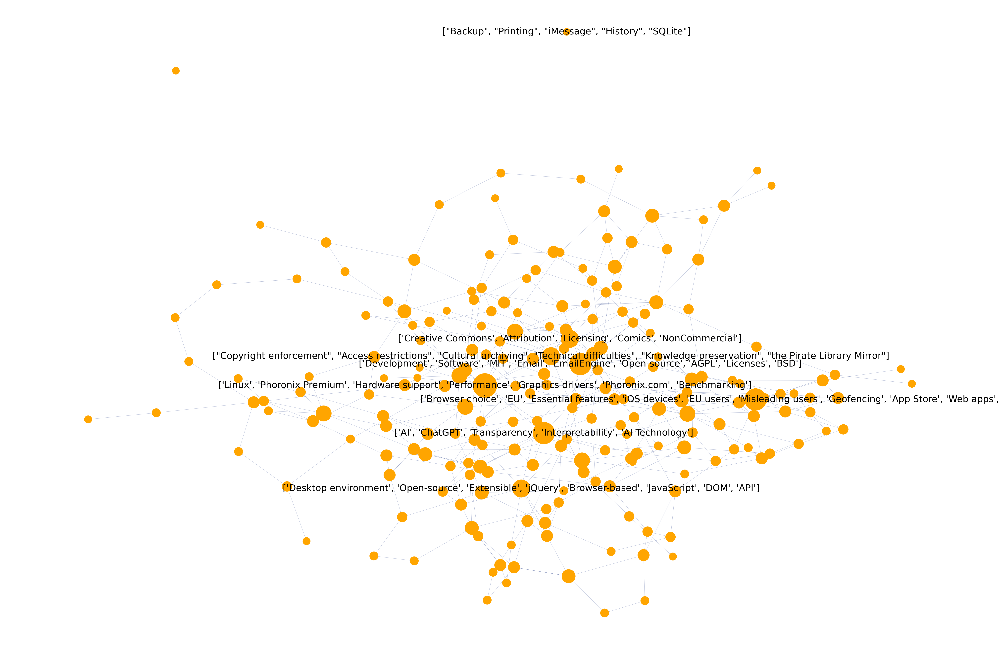

In [149]:
plt.figure(figsize=(60, 40)) 

pos = nx.spring_layout(H, weight='10.0', k=0.1)
labels = get_labels(important_nodes)

nx.draw(H, 
        pos,
        labels = labels, 
        font_size = 40, 
        node_size = [100 * H.degree(node) ** 2 + 1000 for node in H.nodes()],
        node_color = 'orange', 
        edge_color = (0.1, 0.2, 0.5, 0.3)
       )

plt.show()

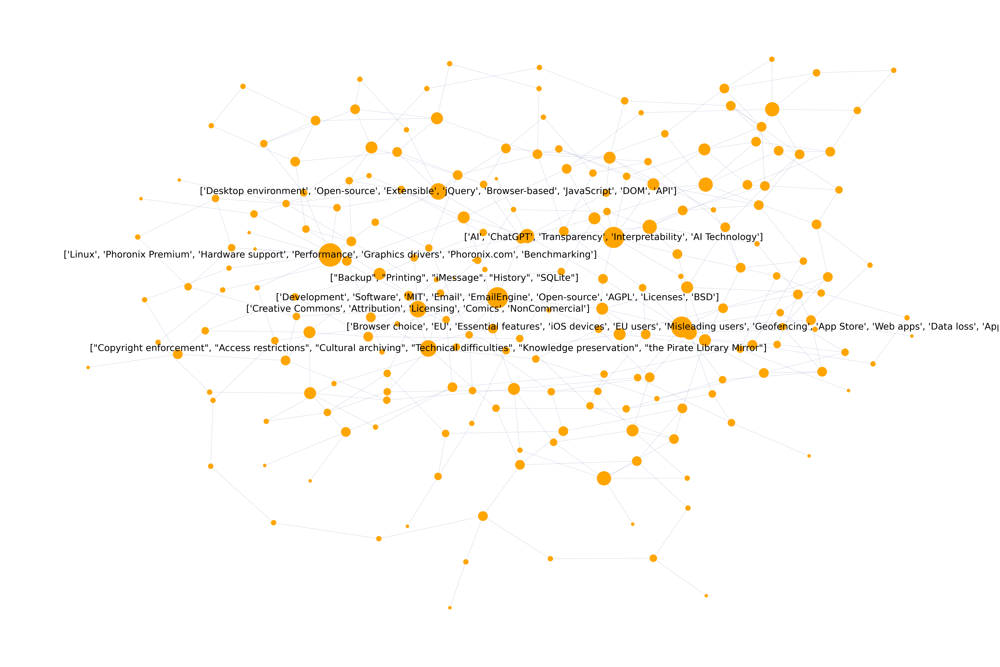

In [150]:
plt.figure(figsize=(60, 40)) 

pos = nx.kamada_kawai_layout(H)

nx.draw(H, 
        pos,
        labels = labels, 
        font_size = 40, 
        node_size = [100 * H.degree(node) ** 2 + 100 for node in H.nodes()],
        node_color = 'orange', 
        edge_color = (0.1, 0.2, 0.5, 0.3)
       )

plt.show()

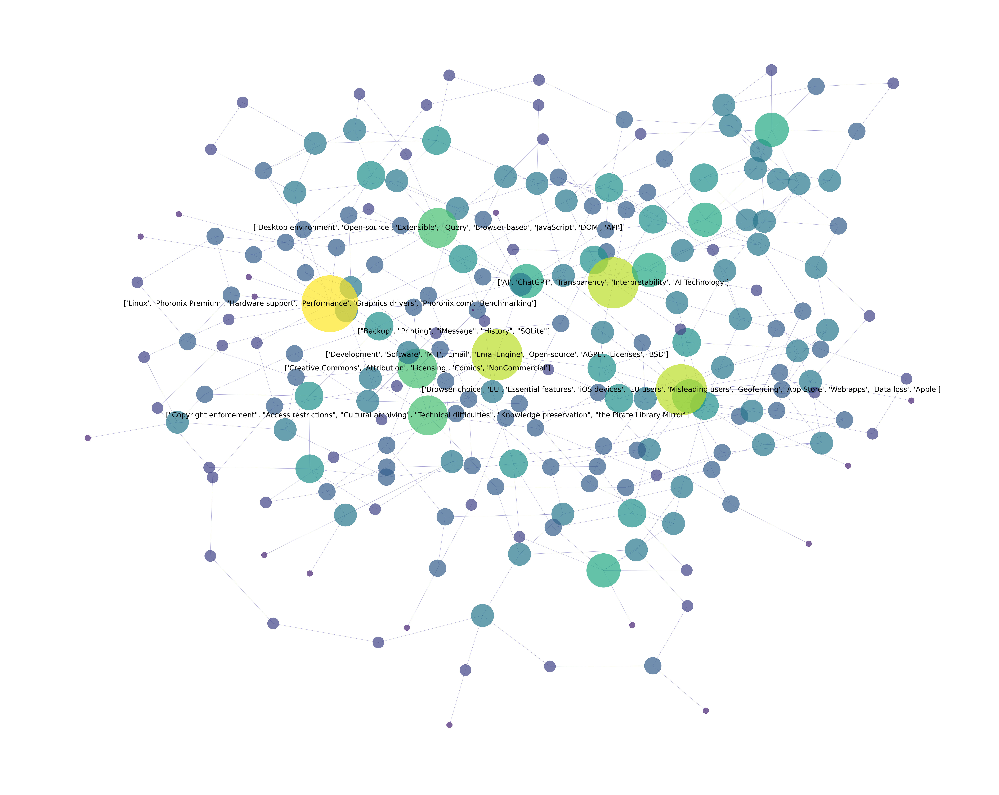

In [166]:
# trying out coloring

pos = nx.kamada_kawai_layout(H)  
plt.figure(figsize=(100, 80))

# color and size by degree (topic popularity)
node_color = [H.degree(node) for node in H.nodes()]
node_size = [1000 * H.degree(node) ** 2 + 100 for node in H.nodes()]

nx.draw_networkx_nodes(H, pos, node_size=node_size, node_color=node_color, cmap='viridis', alpha=0.7)
nx.draw_networkx_edges(H, pos, alpha=0.4, edge_color='darkblue') # transparent edges
nx.draw_networkx_labels(H, pos, labels, font_size=40)

plt.axis('off')  # hides bar axis around the image
plt.show()

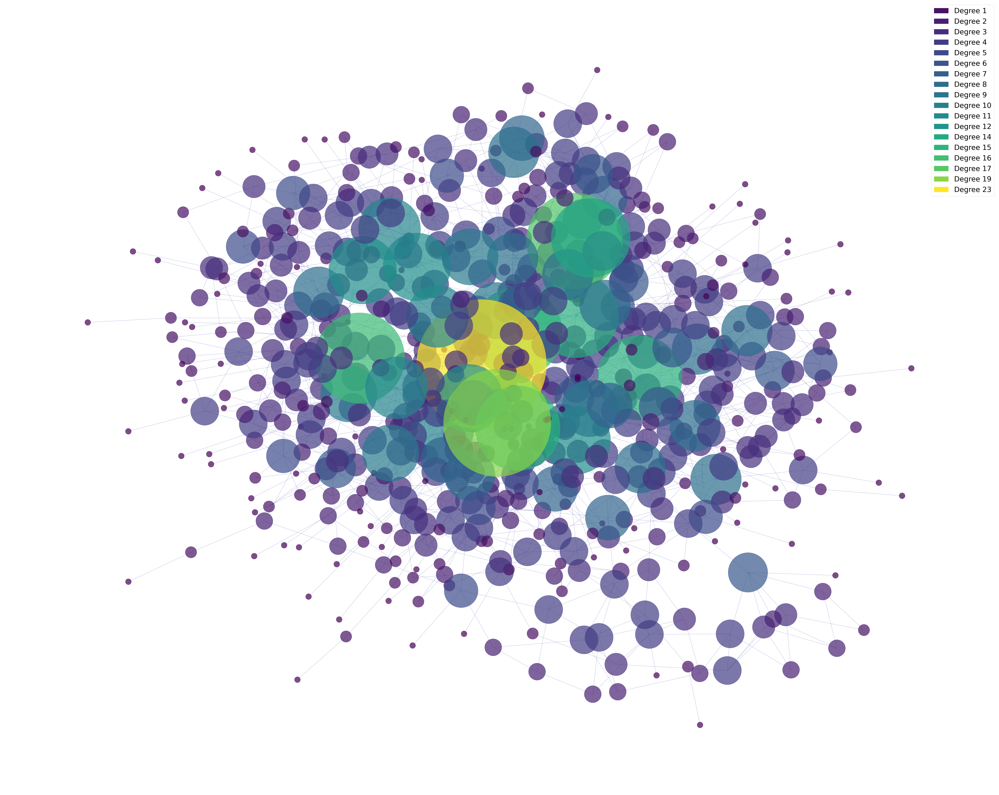

In [187]:
# Original graph, but with a legend to show degree
import matplotlib.patches as mpatches

pos = nx.kamada_kawai_layout(G)  
plt.figure(figsize=(100, 80))

# color and size by degree (topic popularity)
node_color = [G.degree(node) for node in G.nodes()]
node_size = [1000 * G.degree(node) ** 2 + 100 for node in G.nodes()]

nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_color, cmap='viridis', alpha=0.7)
nx.draw_networkx_edges(G, pos, alpha=0.4, edge_color='darkblue') # transparent edges

legend_handles = []
for degree in set(node_color):  # unique degrees for legend
    size = 1000 * degree ** 2 + 100
    label = f'Degree {degree}'
    handle = mpatches.Circle((0, 0), radius=size, color=plt.cm.viridis(degree / max(node_color)))
    legend_handles.append((handle, label))

# Create the legend
plt.legend(handles=[handle for handle, label in legend_handles], 
           labels=[label for handle, label in legend_handles],
           scatterpoints=1,
           loc='upper right',
           ncol=1,
           fontsize=40)

plt.axis('off')  # hides bar axis around the image
plt.show()